### Characterizing bursting dynamics of links (plotting results)

In [1]:
# Path to the toolbox
import sys; sys.path.insert(1, '/home/vinicius/storage1/projects/GrayData-Analysis')
import os 

# GDa functions
import GDa.stats.bursting                as     bst
from   GDa.session                       import session
from   GDa.temporal_network              import temporal_network

import matplotlib.pyplot                 as     plt
import matplotlib
import GDa.graphics.plot                 as     plot

from   mne.viz                           import circular_layout, \
                                                plot_connectivity_circle

import numpy                             as     np
import xarray                            as     xr


from   tqdm                              import tqdm
from   sklearn.manifold                  import TSNE
from   scipy                             import stats

#### Plotting and file saving configurations

In [2]:
SMALL_SIZE, MEDIUM_SIZE, BIGGER_SIZE = plot.set_plot_config()

In [3]:
# Create directory to save figures
if not os.path.exists("img/n5.0.0"):
    os.makedirs("img/n5.0.0")

In [4]:
# Bands names
band_names  = [r'band 1', r'band 2', r'band 3', r'band 4', r'band 5']
stages      = ['baseline', 'cue', 'delay', 'match']
_stats      = [r"$\mu$","std$_{\mu}$",r"$\mu_{tot}$","CV"]

In [5]:
### Methods to read coherence files
def get_coh_file(ks=None, surr=False, mode="morlet"):
    _COH_FILE = f'super_tensor_k_{ks}_surr_{surr}_{mode}.nc'
    return _COH_FILE

### Methods to read burst stats files
def get_bst_file(ks=None, surr=False, rel=False, mode="morlet"):
        return f'~/storage1/projects/GrayData-Analysis/Results/lucy/150128/session01/bs_stats_k_{ks}_surr_{surr}_rel_{rel}_numba_{mode}.nc'

### Visualizing the super tensor

#### Loading session and setting coherence parameters

In [6]:
# Parameters to read the data
idx      = 3 
nses     = 1
nmonkey  = 0
align_to = 'cue'

dirs = { 'rawdata':'/home/vinicius/storage1/projects/GrayData-Analysis/GrayLab',
         'results':'Results/',
         'monkey' :['lucy', 'ethyl'],
         'session':'session01',
         'date'   :[['141014', '141015', '141205', '150128', '150211', '150304'], []] }

In [7]:
#  Instantiating session
ses   = session(raw_path = dirs['rawdata'], monkey = dirs['monkey'][nmonkey], date = dirs['date'][nmonkey][idx],
                session = nses, slvr_msmod = False, align_to = align_to, evt_dt = [-0.65, 3.00])
# Load data
ses.read_from_mat()

In [8]:
# Smoothing windows
sm_times  = 500
sm_freqs  = 1 
sm_kernel = "square"

# Defining parameters
delta = 15       # Downsampling factor
mode  = 'morlet' # ("morlet", "mt_1", "mt_2")
foi   = np.array([
        [0.1, 6.],
        [6., 14.],
        [14., 26.],
        [26., 42.],
        [42., 80.]
            ])

if mode in ["morlet", "mt_1"]:
    n_freqs = 50
    freqs = np.linspace(foi[0,0], foi[-1,1], n_freqs, endpoint=True)
    n_cycles     = freqs/2
    mt_bandwidth = None
    decim_at='tfd'
elif mode == "multitaper":
    freqs = foi.mean(axis=1)
    W     = np.ceil( foi[:,1]-foi[:,0] )   # Bandwidth
    foi   = None
    n_cycles     = np.array([3, 5, 9, 12, 16])
    mt_bandwidth = np.array([2, 4, 4.28, 5.647, 9.65])
    decim_at     = 'coh'

When instantiated, the temporal network object will load the recording info for the monkey, date, and session specified as well as the super tensor; The trial type and the behavioral response can also be specified.

The super-tensor has dimensions [Number of pairs, Number of frequency bands, Number of trials, Time]. For Lucy the frequency bands analysed are:

- band $1$  = [0.1,6]  Hz;
- band $2$  = [6,14]   Hz;
- band $3$  = [14,26]  Hz;
- band $4$  = [26,42]  Hz;
- band $5$  = [42,80]  Hz;

The __temporal_network__ class can also be instantiated by setting threshold as __True__ this will automatically threshold the super-tensor (computed for all trial types independent on how the trial type parameter was set).

### Panel with supertensor, ERP and t-sne projection (q=0.8)

In the cells bellow we perform the burstness analysis for the default thresholding parameter.

In [9]:
def plot_erp(ax, net, i):
    """
    Plot ERP at axis ax, i is used to index a specific frequency band
    """
    plt.sca(ax)
    # Average activation sequences over links
    mu_filtered_super_tensor = net.super_tensor.mean(dim='roi')
    for t in range(net.super_tensor.shape[2]):
        plt.plot(net.time, 
        mu_filtered_super_tensor.isel(trials=t, freqs=i).values, 
        color='b', lw=.1)
    plt.plot(net.time, 
             mu_filtered_super_tensor.isel(freqs=i).median(dim='trials'),
            color='k', lw=3)
    plt.plot(net.time, 
         mu_filtered_super_tensor.isel(freqs=i).quantile(q=5/100,dim='trials'),
        color='r', lw=3)
    plt.plot(net.time, 
    mu_filtered_super_tensor.isel(freqs=i).quantile(q=95/100,dim='trials'),
    color='r', lw=3)
    plt.xlim([net.time[0],net.time[-1]])

def plot_tsne(ax, net, i):
    """
    Plot the t-sne projection at axis ax, i is used to index a specific frequency band
    """
    plt.sca(ax)
    aux = net.super_tensor.isel(freqs=i, trials=slice(0,50))
    aux = aux.stack(observations=("trials","times"))
    Y = TSNE(n_components=2, 
             metric='hamming', 
             perplexity=30.0,
             square_distances=True,
             n_jobs=20).fit_transform(aux.T)
    for i in range(len(stages)):
        plt.plot(Y[net.s_mask[stages[i]][:50*len(net.time)],0], 
                 Y[net.s_mask[stages[i]][:50*len(net.time)],1], 
                 '.', ms=2, label = stages[i])
        plt.legend()

In [10]:
def plot_erp_panel(_KS=None, _SURR=False, _REL=False, title=None):
    # Instantiate network
    q_thr = 0.8
    ## Default threshold
    kw = dict(q=q_thr, keep_weights=False, relative=_REL)

    # Instantiating a temporal network object without thresholding the data
    net =  temporal_network(coh_file=get_coh_file(ks=_KS, surr=_SURR, mode=mode), monkey=dirs['monkey'][nmonkey], 
                            session=1, date='150128', trial_type=[1],
                            behavioral_response=[1], wt=(20,20), drop_trials_after=True,
                            verbose=True, **kw)
    # Mask to track observations within a task-stage
    net.create_stage_masks(flatten=True)

    
    # Plot panel
    fig = plt.figure(figsize=(10, 7), dpi=600)

    gs1 = fig.add_gridspec(nrows=1, ncols=1, left=0.05, right=0.95, bottom=0.5, top=0.95)
    gs2 = fig.add_gridspec(nrows=1, ncols=3, width_ratios=(1,0.001,0.6), left=0.05, right=0.95, bottom=0.08, top=0.4)
    # Panel A
    ax1 = plt.subplot(gs1[0])
    plt.sca(ax1)
    plt.imshow(net.super_tensor[:,1,:10,:].stack(observations=('trials','times')), 
               aspect = 'auto', cmap = 'gray', origin = 'lower', 
               extent = [0, 10*len(net.time), 1, net.super_tensor.sizes['roi']], vmin=0, vmax=1)
    plt.ylabel("Edge index", fontsize=SMALL_SIZE)
    plt.xlabel('Time [a.u]', fontsize=SMALL_SIZE)
    # Panel B
    ax2 = plt.subplot(gs2[0])
    ax3 = plt.subplot(gs2[2])

    plot_erp(ax2,  net, 1)
    plt.ylabel(r'$\langle C_{ij} \rangle$', fontsize=SMALL_SIZE)
    plt.xlabel('Time [s]', fontsize=SMALL_SIZE)
    plot_tsne(ax3, net, 1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(r"tsne$_x$")
    plt.ylabel(r"tsne$_y$")

    bg = plot.Background(visible=False)
    plot.add_panel_letters(fig, axes=[ax1, ax2, ax3], fontsize=18,
                           xpos=[-0.045,-0.1,-0.13], ypos=[1.0, 1.0, 1.0]);
    
    bg.axes.text(0.50, 1.0, title, ha='center', fontsize=MEDIUM_SIZE)

    plt.savefig(f"img/n5.0.0/figure0_surr_{_SURR}_ks_{_KS}_rel_{_REL}_{mode}.png")

#### Original data and absolute threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [01:20<00:00, 16.09s/it]


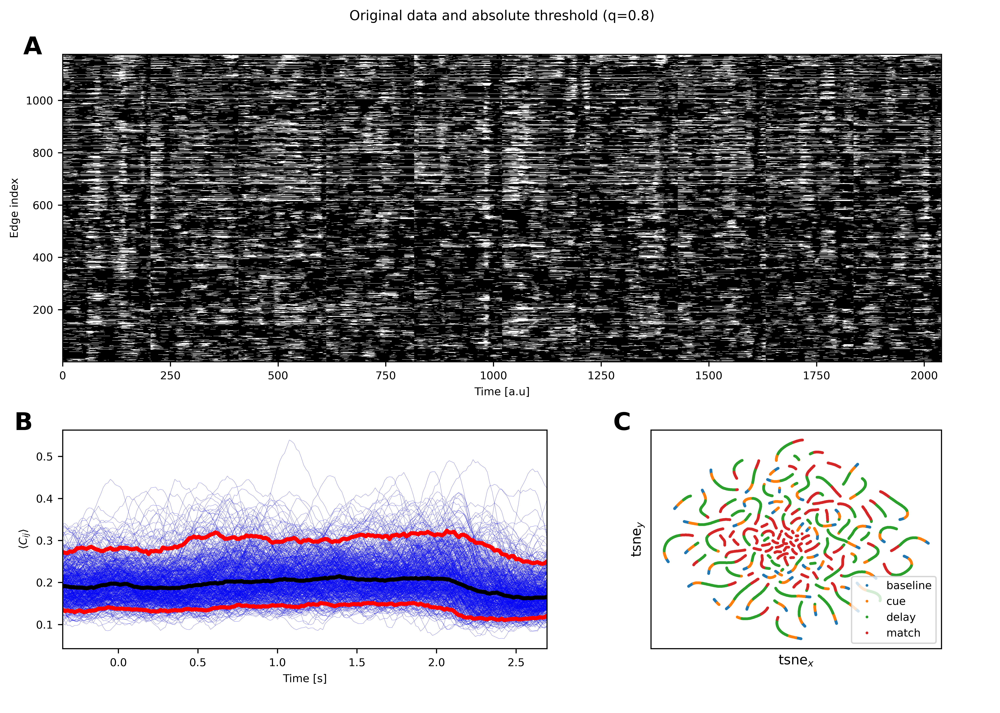

In [11]:
plot_erp_panel(_KS=500, _SURR=False, _REL=False, title=r"Original data and absolute threshold (q=0.8)")

#### Original data and relative threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [00:49<00:00,  9.83s/it]


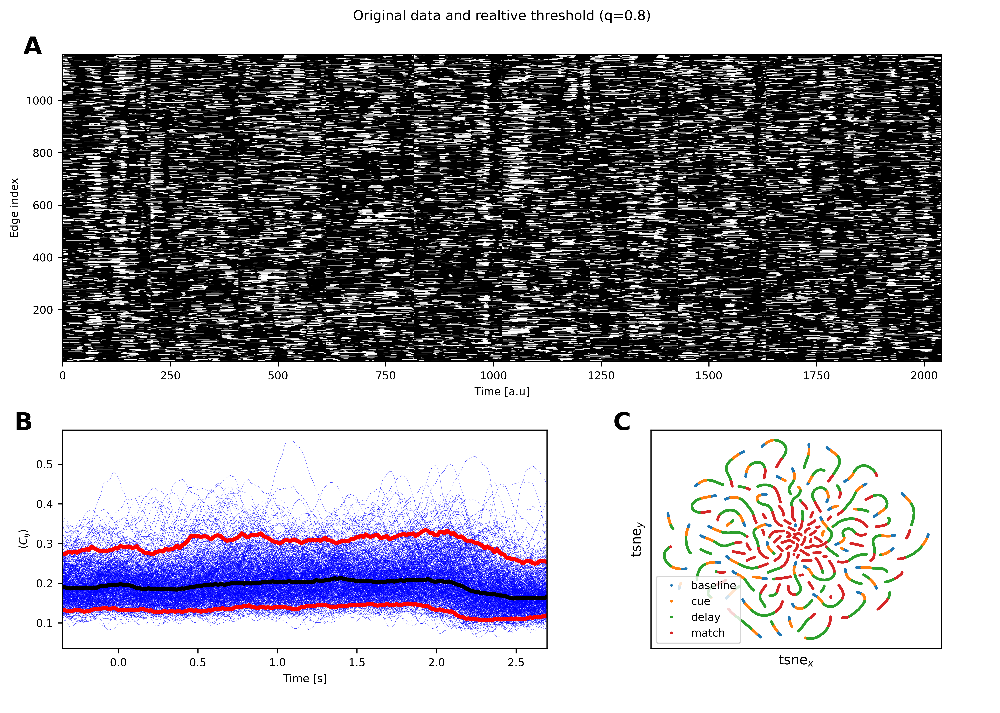

In [12]:
plot_erp_panel(_KS=500, _SURR=False, _REL=True, title=r"Original data and realtive threshold (q=0.8)")

#### Surrogate data and absolute threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [01:18<00:00, 15.71s/it]


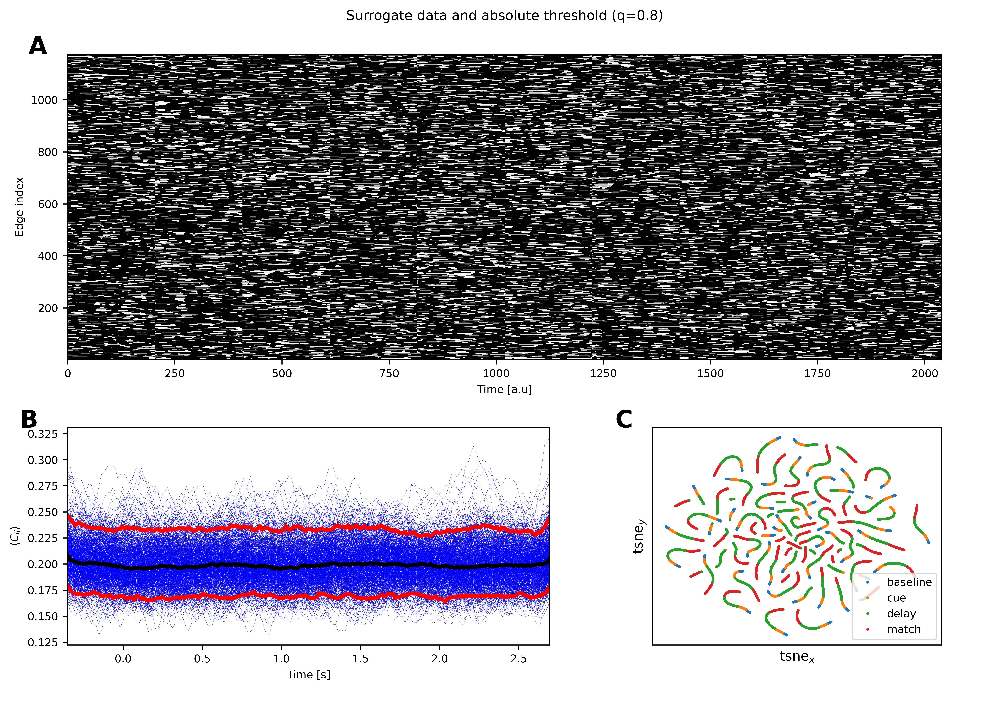

In [13]:
plot_erp_panel(_KS=500, _SURR=True, _REL=False, title=r"Surrogate data and absolute threshold (q=0.8)")

#### Surrogate data and relative threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [00:49<00:00,  9.85s/it]


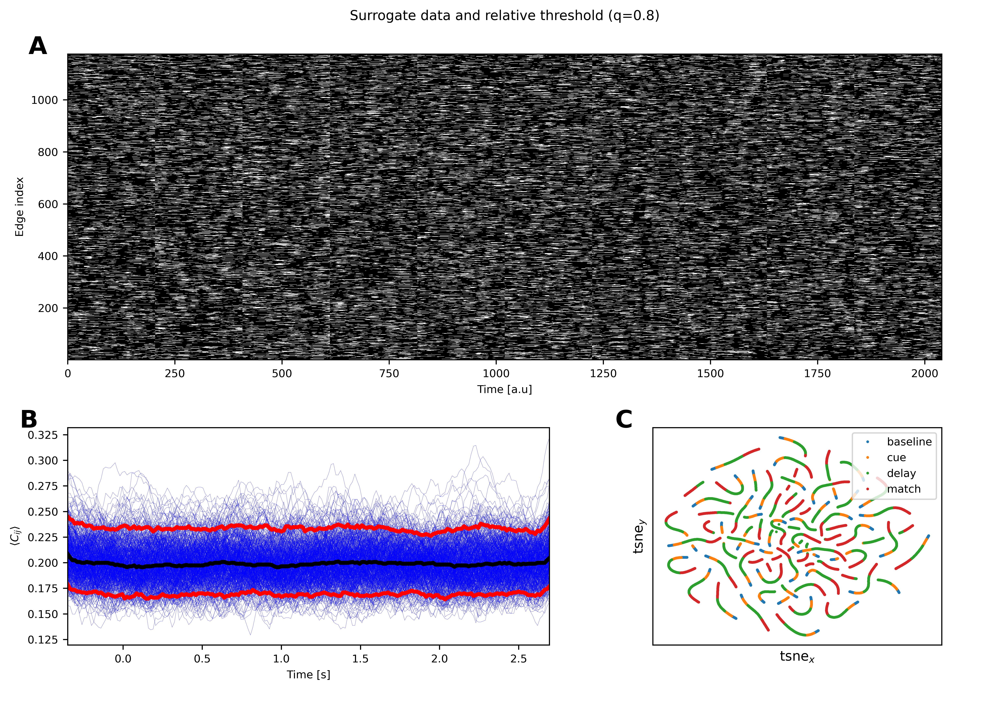

In [14]:
plot_erp_panel(_KS=500, _SURR=True, _REL=True, title=r"Surrogate data and relative threshold (q=0.8)")

### Burstness statistics

In [15]:
def plot_q_dependece(ax, bs_stats,stats,freq,ylabel=None):
    plt.sca(ax)
    # Axis limits
    _xlim0, _xlim1 = bs_stats.thr[0],bs_stats.thr[-1]
    _ylim0, _ylim1 = bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").min()-0.05, bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").max()+0.05
    # Number of edges
    n_edges = bs_stats.sizes["roi"]
    # Compute the median over edges
    _median = bs_stats.isel(stats=stats,freqs=freq).median(dim="roi")
    # Compute the 5% quantile over edges
    _q005   = bs_stats.isel(stats=stats,freqs=freq).quantile(0.05, dim="roi", keep_attrs=True) #/ np.sqrt(n_edges)
    # Compute the 95% quantile over edges
    _q095   = bs_stats.isel(stats=stats,freqs=freq).quantile(0.95, dim="roi", keep_attrs=True) #/ np.sqrt(n_edges)
    for s in range(_median.sizes["stages"]):
        plt.plot(bs_stats.thr, _median.isel(stages=s))
        plt.fill_between(bs_stats.thr, 
                         _q005.isel(stages=s),
                         _q095.isel(stages=s), alpha=0.2)
    plt.vlines(bs_stats.thr.values[1], _ylim0, _ylim1, color="gray")
    plt.vlines(bs_stats.thr.values[6], _ylim0, _ylim1, ls='--', color="gray")
    plt.xlim(_xlim0, _xlim1)
    plt.ylim(_ylim0, _ylim1)
    plt.ylabel(ylabel, fontsize=MEDIUM_SIZE)

def plot_stats_dist(ax, bs_stats, stats, freq, thr, nbins, xlabel=None, legend=None):
    plt.sca(ax)
    _ylim0, _ylim1 = bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").min()-0.05, bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").max()+0.05
    bins=np.linspace(_ylim0, _ylim1,50)
    for i in range(bs_stats.sizes["stages"]):
        plt.hist(bs_stats.isel(stats=stats,stages=i,thr=thr, freqs=freq), bins=bins, density=True, lw=1, histtype='step', fill=False, label=stages[i], orientation='horizontal')
    if isinstance(legend, list):
        plt.legend( prop={'size': 5})
    plt.ylabel(xlabel, fontsize=MEDIUM_SIZE)

In [16]:
def plot_panel_bst(_KS=None, _SURR=False, _REL=False, title=None):
    
    bs_stats = xr.load_dataarray( get_bst_file(ks=_KS, surr=_SURR, rel=_REL, mode=mode) )
    
    
    # For the histograms of each measurement
    nbins  = 100

    fig = plt.figure(figsize=(7, 8), dpi=150)

    gs1 = fig.add_gridspec(nrows=4, ncols=3, left=0.1, right=0.95, bottom=0.05, top=0.9, wspace=0.3, hspace=.3)

    # Panel A
    ax1 = plt.subplot(gs1[0])
    ax2 = plt.subplot(gs1[3])
    ax3 = plt.subplot(gs1[6])
    ax4 = plt.subplot(gs1[9])

    #### Plotting dependence on threshold of the metrics #####
    plot_q_dependece(ax1, bs_stats, 0, 1, ylabel=_stats[0]+" [s]")
    plt.legend(stages, prop={'size': 5})
    plot_q_dependece(ax2, bs_stats, 1, 1, ylabel=_stats[1]+" [s]")
    plot_q_dependece(ax3, bs_stats, 2, 1, ylabel=_stats[2])
    plot_q_dependece(ax4, bs_stats, 3, 1, ylabel=_stats[3])
    plt.xlabel("q", fontsize=MEDIUM_SIZE)

    # Panel B
    ax5 = plt.subplot(gs1[1])
    ax6 = plt.subplot(gs1[4])
    ax7 = plt.subplot(gs1[7])
    ax8 = plt.subplot(gs1[10])

    ##### Histograms for low threshold ####
    # Mean active time
    plot_stats_dist(ax5, bs_stats, 0, 1, 1, nbins, xlabel=None, legend=stages)
    # STD of mean active time
    plot_stats_dist(ax6, bs_stats, 1, 1, 1, nbins, xlabel=None, legend=None)
    # Total active time
    plot_stats_dist(ax7, bs_stats, 2, 1, 1, nbins, xlabel=None, legend=None)
    # CV
    plot_stats_dist(ax8, bs_stats, 3, 1, 1, nbins, xlabel=None, legend=None)
    plt.xlabel("#count", fontsize=MEDIUM_SIZE)

    # Panel C
    ax9  = plt.subplot(gs1[2])
    ax10 = plt.subplot(gs1[5])
    ax11 = plt.subplot(gs1[8])
    ax12 = plt.subplot(gs1[11])

    ##### Histograms for high threshold ####
    # Mean active time
    plot_stats_dist(ax9,  bs_stats, 0, 1, 6, nbins, xlabel=None, legend=stages)
    # STD of mean active time
    plot_stats_dist(ax10, bs_stats, 1, 1, 6, nbins, xlabel=None, legend=None)
    # Total active time
    plot_stats_dist(ax11, bs_stats, 2, 1, 6, nbins, xlabel=None, legend=None)
    # CV
    plot_stats_dist(ax12, bs_stats, 3, 1, 6, nbins, xlabel=None, legend=None)
    plt.xlabel("#count", fontsize=MEDIUM_SIZE)
    
    for index in range(12):
        fig.get_axes()[index].spines['right'].set_visible(False)
        fig.get_axes()[index].spines['top'].set_visible(False)

    bg = plot.Background(visible=False)
    #bg.box((0.32, 0.65, 0.01, 0.95), lw=2)
    #bg.box((0.66, 0.99, 0.01, 0.95), lw=2, ls='--')
    bg.axes.text(0.50, 0.96, title, ha='center', fontsize=MEDIUM_SIZE);
    plot.add_panel_letters(fig, axes=[ax1, ax5, ax9], fontsize=18,
                               xpos=[-0.15,-0.15,-0.15], ypos=[1.1, 1.1, 1.1]);
    bg.hline(0.92, x0=0.407, x1=0.637, lw=2)
    bg.hline(0.92, x0=0.71, x1=0.952, lw=2, ls="--")
    plt.savefig(f"img/n5.0.0/qdependence_surr_{_SURR}_ks_{_KS}_rel_{_REL}_{mode}.png")

#### Original data and absolute threshold

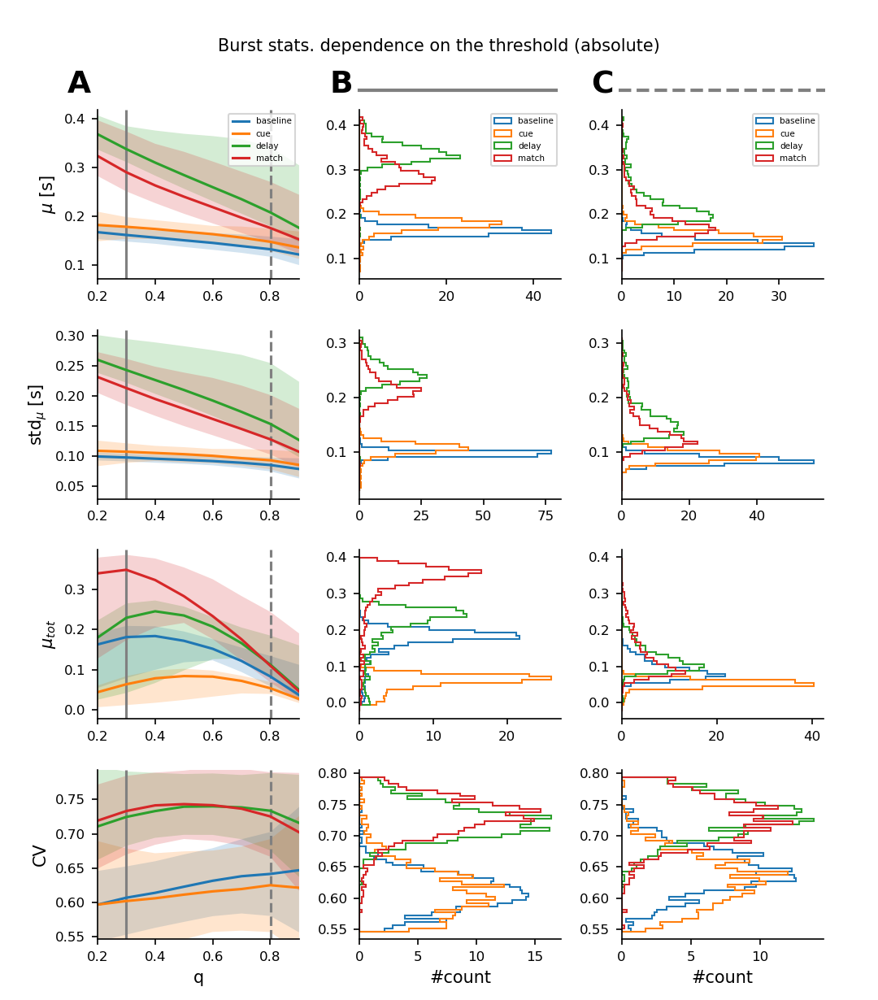

In [17]:
plot_panel_bst(_KS=500, _SURR=False, _REL=False, title="Burst stats. dependence on the threshold (absolute)")

#### Original data and relative threshold

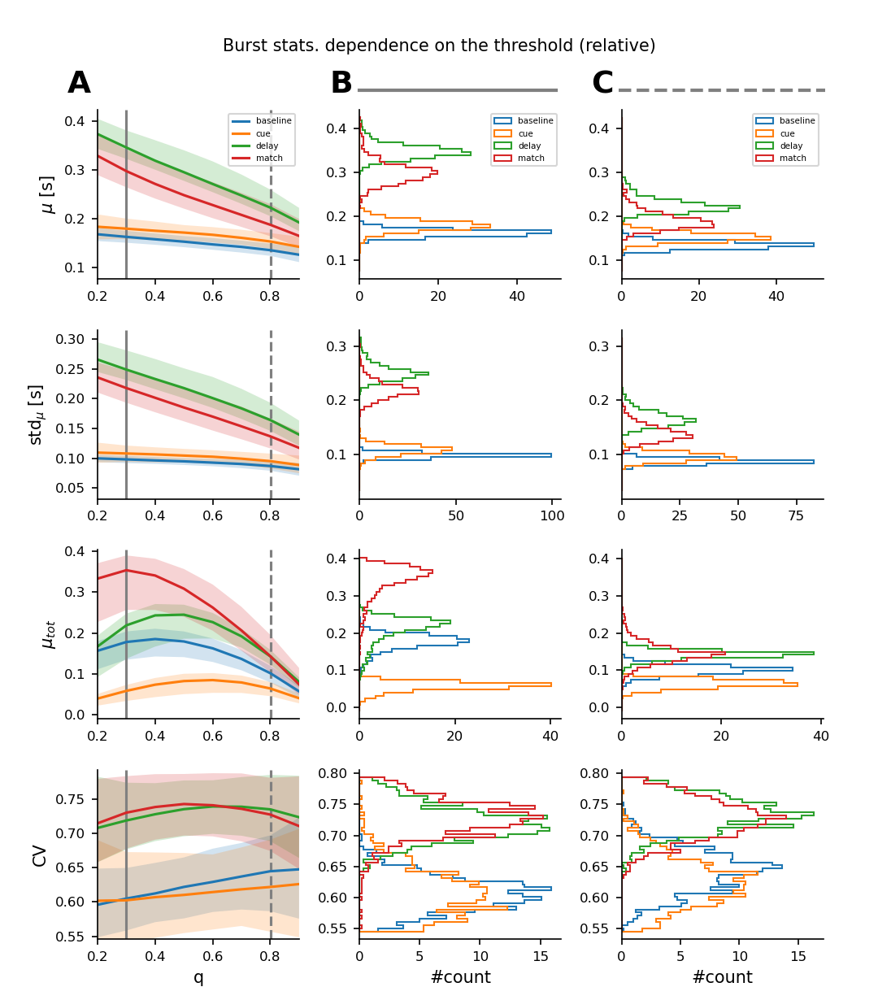

In [18]:
plot_panel_bst(_KS=500, _SURR=False, _REL=True, title="Burst stats. dependence on the threshold (relative)")

#### Surrogate data and absolute threshold

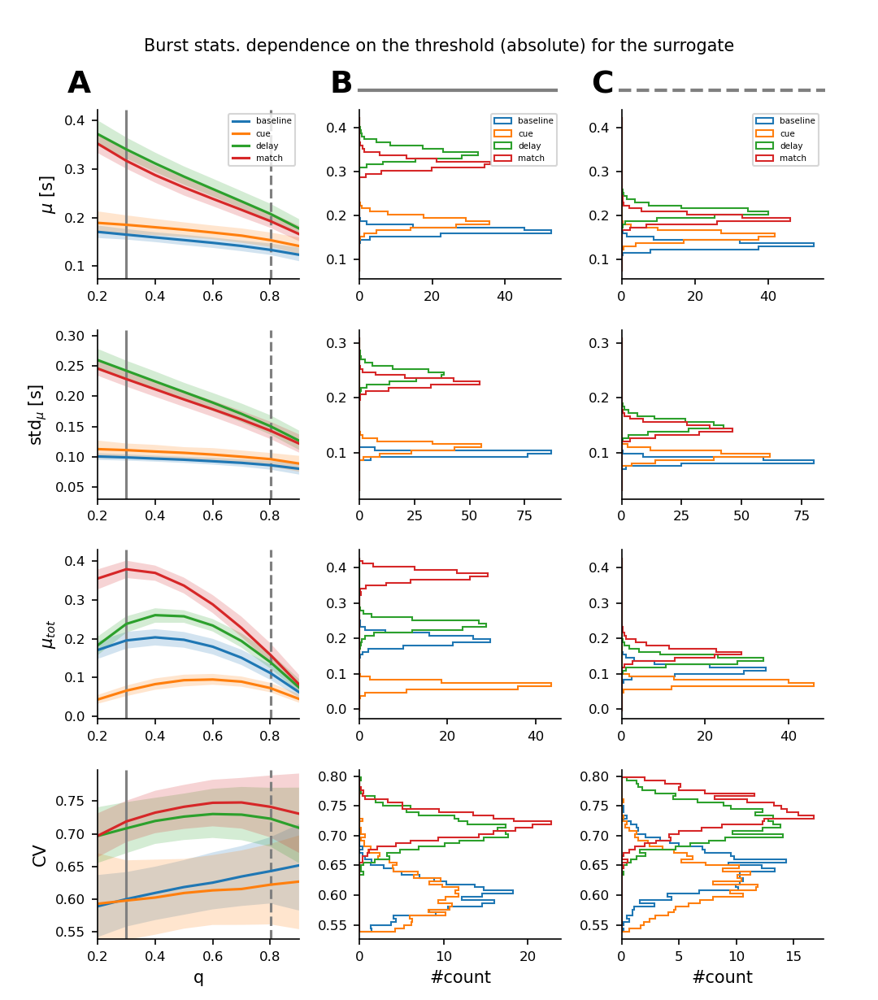

In [19]:
plot_panel_bst(_KS=500, _SURR=True, _REL=False, title="Burst stats. dependence on the threshold (absolute) for the surrogate")

#### Surrogate data and relative threshold

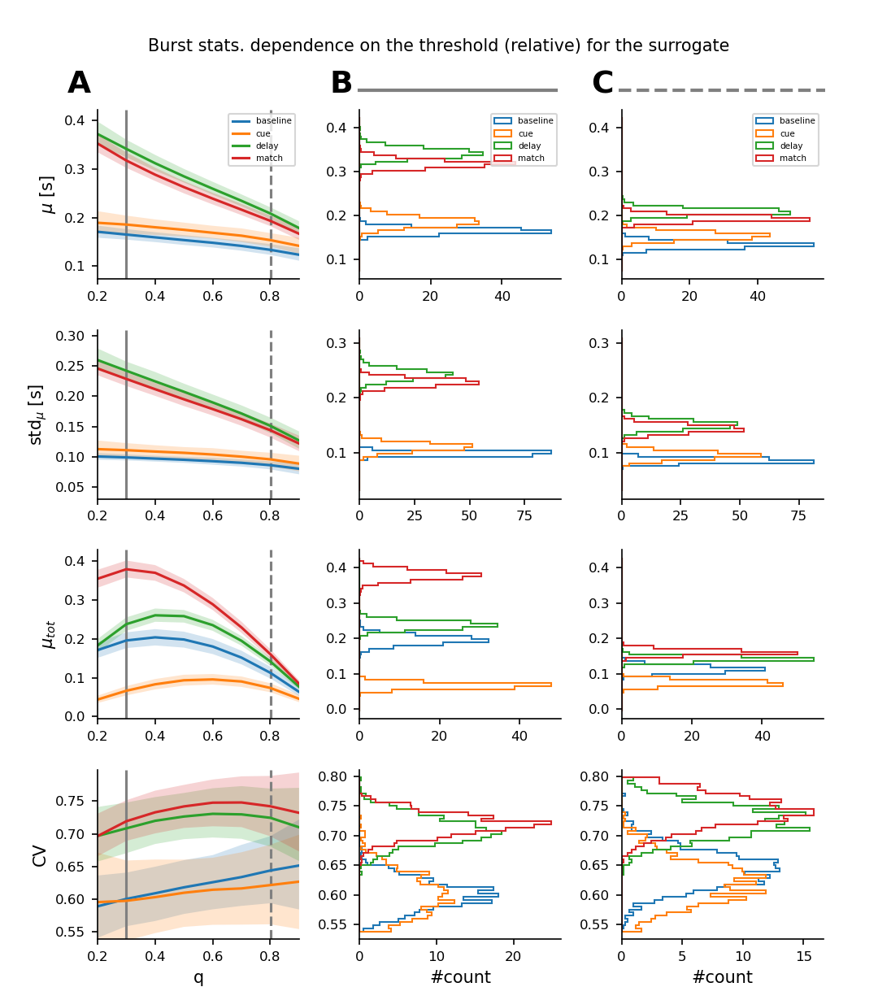

In [20]:
plot_panel_bst(_KS=500, _SURR=True, _REL=True, title="Burst stats. dependence on the threshold (relative) for the surrogate")

### Burstiness statistics - comparison with surrogates

#### Absolute threshold

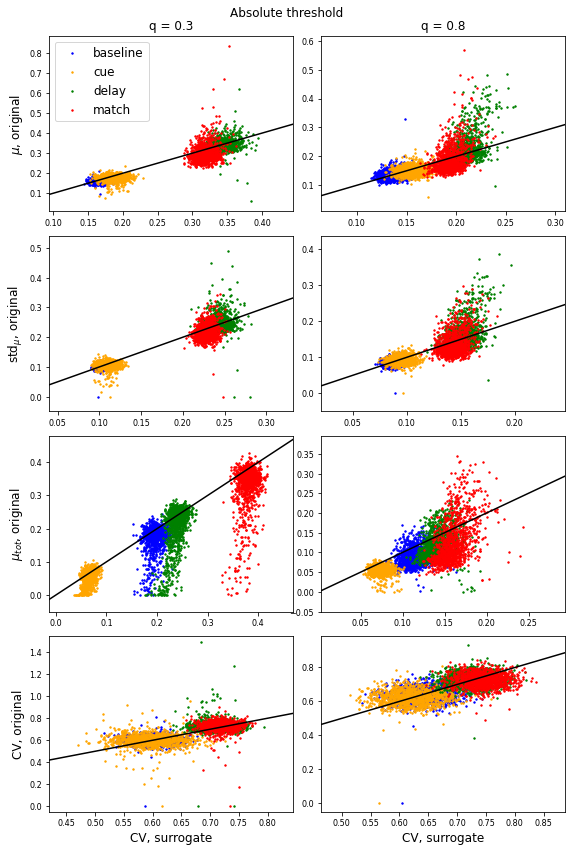

In [208]:
# Original 
bs_o = xr.load_dataarray( get_bst_file(ks=500, surr=False, rel=False) )
# Surrogate
bs_s = xr.load_dataarray( get_bst_file(ks=500, surr=True, rel=False) )

x = np.linspace(-20,20,100)
y = x

plt.figure(figsize=(8,12))
c     = ['blue', 'orange', 'green', 'red']
count = 1
for i in range(bs_o.sizes["stats"]):
    for q in [1,6]:
        plt.subplot(4,2,count)
        for s in range(4):
            plt.scatter(bs_s.isel(thr=q,stages=s,stats=i, freqs=1), bs_o.isel(thr=q,stages=s,stats=i, freqs=1), c=c[s], s=2, label=f"{stages[s]}")
        plt.xlim(bs_s.isel(stats=i, thr=q, freqs=1).min()-0.05, bs_s.isel(stats=i, thr=q, freqs=1).max()+0.05)
        plt.ylim(bs_o.isel(stats=i, thr=q, freqs=1).min()-0.05, bs_o.isel(stats=i, thr=q, freqs=1).max()+0.05)
        if i==0 and q==1: plt.legend(fontsize=BIGGER_SIZE)
        if i==0 and q==1: plt.title(f"q = {np.round(bs_o.thr.values[q],2)}", fontsize=BIGGER_SIZE)
        if i==0 and q==6: plt.title(f"q = {bs_o.thr.values[q].round(2)}", fontsize=BIGGER_SIZE)
        if q==1: plt.ylabel(f"{_stats[i]}" + ", original", fontsize=BIGGER_SIZE)
        if i==3: plt.xlabel(f"{_stats[i]}" + ", surrogate", fontsize=BIGGER_SIZE)
        plt.plot(x,y, "k")
        count+=1
plt.suptitle("Absolute threshold", fontsize=BIGGER_SIZE)
plt.tight_layout()

#### Relative threshold

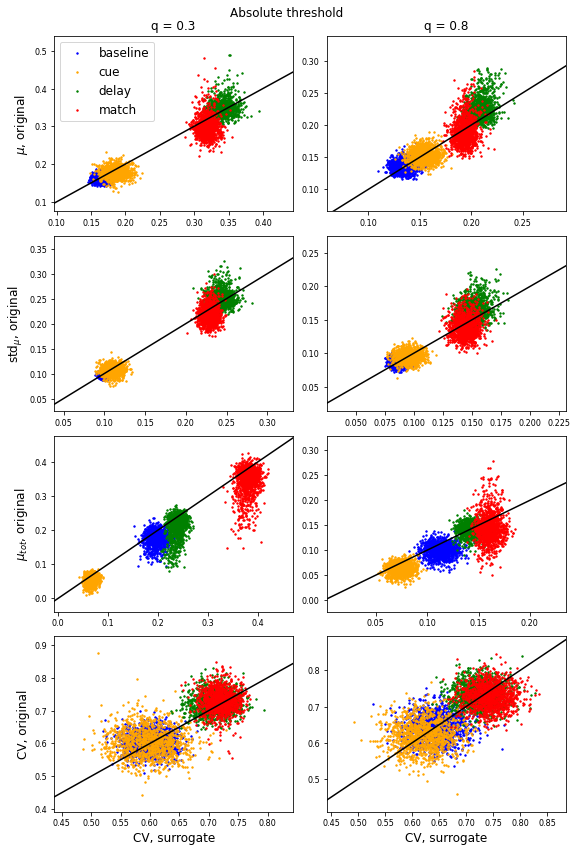

In [209]:
# Original 
bs_o = xr.load_dataarray( get_bst_file(ks=500, surr=False, rel=True) )
# Surrogate
bs_s = xr.load_dataarray( get_bst_file(ks=500, surr=True, rel=True) )

x = np.linspace(-20,20,100)
y = x

plt.figure(figsize=(8,12))
c     = ['blue', 'orange', 'green', 'red']
count = 1
for i in range(bs_o.sizes["stats"]):
    for q in [1,6]:
        plt.subplot(4,2,count)
        for s in range(4):
            plt.scatter(bs_s.isel(thr=q,stages=s,stats=i, freqs=1), bs_o.isel(thr=q,stages=s,stats=i, freqs=1), c=c[s], s=2, label=f"{stages[s]}")
        plt.xlim(bs_s.isel(stats=i, thr=q, freqs=1).min()-0.05, bs_s.isel(stats=i, thr=q, freqs=1).max()+0.05)
        plt.ylim(bs_o.isel(stats=i, thr=q, freqs=1).min()-0.05, bs_o.isel(stats=i, thr=q, freqs=1).max()+0.05)
        if i==0 and q==1: plt.legend(fontsize=BIGGER_SIZE)
        if i==0 and q==1: plt.title(f"q = {np.round(bs_o.thr.values[q],2)}", fontsize=BIGGER_SIZE)
        if i==0 and q==6: plt.title(f"q = {bs_o.thr.values[q].round(2)}", fontsize=BIGGER_SIZE)
        if q==1: plt.ylabel(f"{_stats[i]}" + ", original", fontsize=BIGGER_SIZE)
        if i==3: plt.xlabel(f"{_stats[i]}" + ", surrogate", fontsize=BIGGER_SIZE)
        plt.plot(x,y, "k")
        count+=1
plt.suptitle("Absolute threshold", fontsize=BIGGER_SIZE)
plt.tight_layout()

#### Distance dependence original

In [493]:
x=bs_o.isel(thr=7, freqs=1, stats=0).values
y=net.super_tensor.attrs["d_eu"]

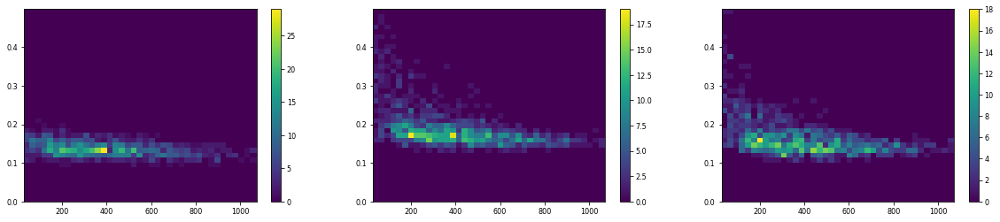

In [494]:
plt.figure(figsize=(20,4))
for i in range(1,4):
    x[:,i]=x[:,i]-x[:,0]
for i in range(1,4):
    plt.subplot(1,3,i)
    plt.hist2d( y, x[:,i], bins=( np.linspace(y.min(),y.max(),40), np.linspace(np.nanmin(x),np.nanmax(x),40) ), 
                )
    plt.colorbar()

/home/vinicius/anaconda3/lib/python3.8/site-packages/numpy/lib/histograms.py:1056: RuntimeWarning: invalid value encountered in greater
  if np.any(edges[i][:-1] > edges[i][1:]):


ValueError: x and y arguments to pcolormesh cannot have non-finite values or be of type numpy.ma.core.MaskedArray with masked values

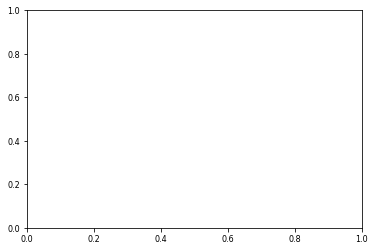

In [406]:
plt.hist2d(x,y, bins=(np.linspace(x.min(),x.max(),20),np.linspace(y.min(),y.max(),20)))

### Single-link plot of the stats

In [360]:
###################################################################################
# Convert array with links stats to matrix (roi, roi)
###################################################################################
def get_stats_mat(_REL=False):
    
    ###################################################################################
    # Instantiate network to get parameters
    ###################################################################################

    q_thr = None
    ## Default threshold
    kw = dict(q=q_thr)

    # Instantiating a temporal network object without thresholding the data
    net =  temporal_network(coh_file=get_coh_file(ks=500, surr=False, mode="morlet"), monkey=dirs['monkey'][nmonkey], 
                            session=1, date='150128', trial_type=[1],
                            behavioral_response=[1], wt=(20,20), drop_trials_after=True,
                            verbose=True, **kw)
    # Original 
    bs_o = xr.load_dataarray( get_bst_file(ks=500, surr=False, rel=_REL) )
    # Surrogate
    bs_s = xr.load_dataarray( get_bst_file(ks=500, surr=True, rel=_REL) )
    
    x_s, x_t = net.super_tensor.attrs["sources"], net.super_tensor.attrs["targets"]
    
    size = (bs_s.sizes["thr"],bs_o.sizes["stats"], bs_o.sizes["stages"], net.super_tensor.attrs["nC"],net.super_tensor.attrs["nC"])
    
    bs_mat      = np.zeros(size)
    bs_mat_surr = np.zeros(size)
    
    for q in range(bs_s.sizes["thr"]):
        for s in range(bs_s.sizes["stats"]):
            for st in range(bs_s.sizes["stages"]):
                for p, (i,j) in enumerate( zip(x_s, x_t) ):
                    bs_mat[q,s,st,i,j]      = bs_mat[q,s,st,j,i]      = bs_o.isel(thr=q,stages=st,stats=s,freqs=1,roi=p).values
                    bs_mat_surr[q,s,st,i,j] = bs_mat_surr[q,s,st,j,i] = bs_s.isel(thr=q,stages=st,stats=s,freqs=1,roi=p).values
            
    return bs_mat, bs_mat_surr

In [376]:
###################################################################################
# Defining plot functions
###################################################################################
def plot_conn_sig(data, thr, sidx, stidx, surr=False, top=20, _colorbar=False, _title=False, subplot=111):
    """
    Plot connectivity circle with links with top
    signigicant coherence distribution for a given band
    """
    
    if _title: title=f"{_stats[sidx]}"
    else: title=None
    
    fig = plt.figure(figsize=(5,5))
    plot_connectivity_circle(data[thr,sidx,stidx], net.super_tensor.attrs["areas"], colormap="hot_r", vmin=0, vmax=data[:,sidx].mean()/2, 
                             facecolor="white", n_lines=top, textcolor="k", fig=fig, colorbar=_colorbar, padding=1, linewidth=2,
                             title=title, fontsize_title=20,fontsize_names=12, subplot=subplot, show=False);
    plt.savefig(f"img/n5.0.0/top_stats_{sidx}__stages_{stidx}_thr_{thr}_surr_{surr}_top_{top}.png", transparent=True, bbox_inches='tight', dpi=300)
    plt.close()
    
def plot_circles(ax, thr, sidx, stidx, surr, top=20):
    """
    Plot olympics circles to the given axes.
    """
    
    png = plt.imread(f"img/n5.0.0/top_stats_{sidx}__stages_{stidx}_thr_{thr}_surr_{surr}_top_{top}.png")
    plt.sca(ax)
    im = plt.imshow(png, interpolation='none')
    #plt.axis('off')    
    pad = 2
    plt.xlim(-pad, png.shape[1]+pad)
    plt.ylim(png.shape[0]+pad, -pad)
    return png

### Absolute threshold

In [372]:
_REL = False

In [374]:
bs_mat, bs_mat_surr = get_stats_mat(_REL=_REL)

In [375]:
for q in [0,4,7]:
    for s in range(bs_o.sizes["stats"]):
        for st in range(bs_o.sizes["stages"]):
            plot_conn_sig(bs_mat, q, s, st, surr=False, top=20, _colorbar=False, _title=False, subplot=111);
            plot_conn_sig(bs_mat_surr, q, s, st, surr=True, top=20, _colorbar=False, _title=False, subplot=111);

/home/vinicius/.local/lib/python3.8/site-packages/mne/viz/circle.py:305: RuntimeWarning: invalid value encountered in greater_equal
  con_draw_idx = np.where(con_abs >= con_thresh)[0]


In [384]:
def plot_conn_stage(stage, surr,top):
    fig = plt.figure(figsize=(6,8), dpi=300)

    gs1 = fig.add_gridspec(nrows=4, ncols=3, left=0.05, right=0.95, bottom=0.05, top=0.90, wspace=0.01, hspace=0.01)

    # Panel A
    ax1 = plt.subplot(gs1[0])
    ax2 = plt.subplot(gs1[1])
    ax3 = plt.subplot(gs1[2])
    ax4 = plt.subplot(gs1[3])
    ax5 = plt.subplot(gs1[4])
    ax6 = plt.subplot(gs1[5])
    ax7 = plt.subplot(gs1[6])
    ax8 = plt.subplot(gs1[7])
    ax9 = plt.subplot(gs1[8])
    ax10 = plt.subplot(gs1[9])
    ax11 = plt.subplot(gs1[10])
    ax12 = plt.subplot(gs1[11])

    ax_list = fig.get_axes()

    count=1
    for s in range(bs_o.sizes["stats"]):
        for q in [0,4,7]:
            plot_circles(ax_list[count-1], q, s, stage, surr, top=top) 
            if s==0: 
                plt.title(f"q={np.round(bs_o.thr.values[q],2)}", fontsize=MEDIUM_SIZE)
            if q==0: 
                plt.ylabel(_stats[s], fontsize=MEDIUM_SIZE)
            ax_list[count-1].set_yticklabels([])
            ax_list[count-1].set_xticklabels([])
            ax_list[count-1].set_xticks([])
            ax_list[count-1].set_yticks([])
            ax_list[count-1].spines['top'].set_visible(False)
            ax_list[count-1].spines['bottom'].set_visible(False)
            ax_list[count-1].spines['left'].set_visible(False)
            ax_list[count-1].spines['right'].set_visible(False)
            count += 1   

    plot.add_panel_letters(fig, axes=[ax1, ax4, ax7, ax10], fontsize=18,
                       xpos=[-0.1]*4, ypos=[0.9]*4);
    if surr: plt.suptitle(f"Absolute threshold, {stages[stage]} (surrogate)")
    else: plt.suptitle(f"Absolute threshold, {stages[stage]}")
    bg = plot.Background(visible=False)
    plt.savefig(f"img/n5.0.0/top_stages_{stage}_surr_{surr}_top_{top}.png", transparent=True, bbox_inches='tight', dpi=300)

#### Baseline original

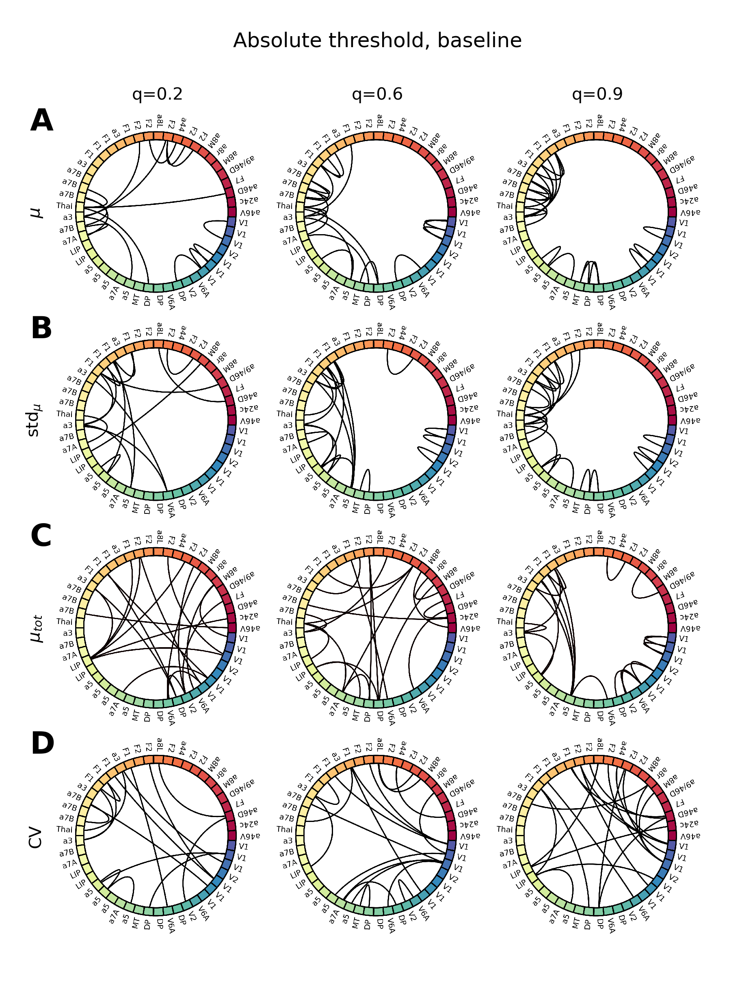

In [385]:
plot_conn_stage(0, False,20)

#### Baseline surrogate

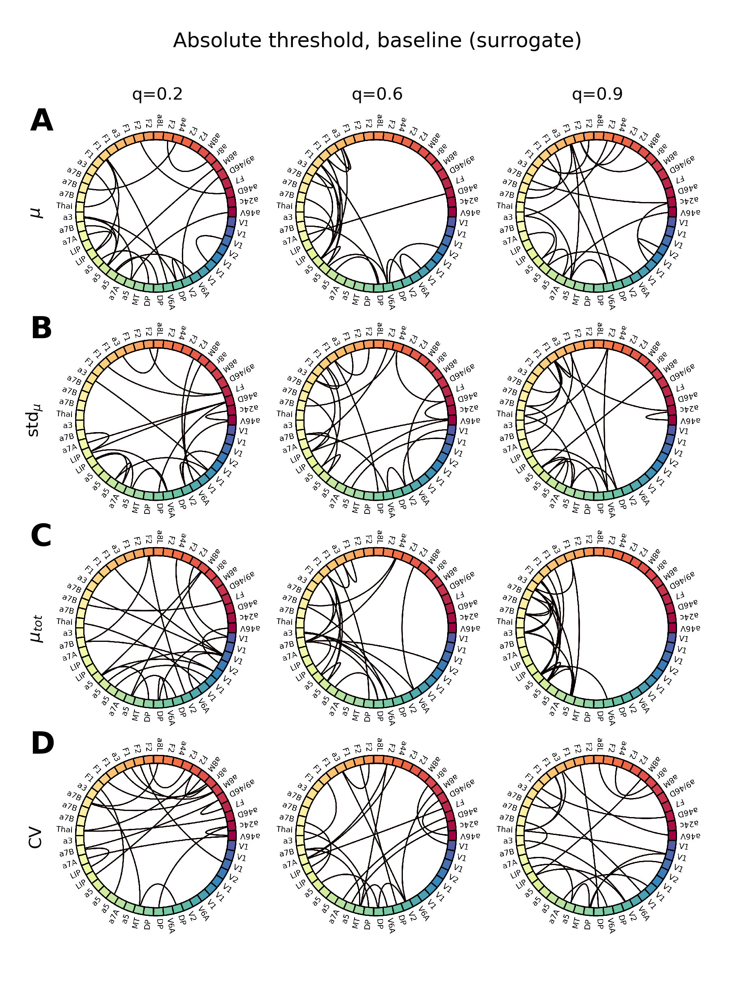

In [391]:
plot_conn_stage(0, True,20)

#### Cue original

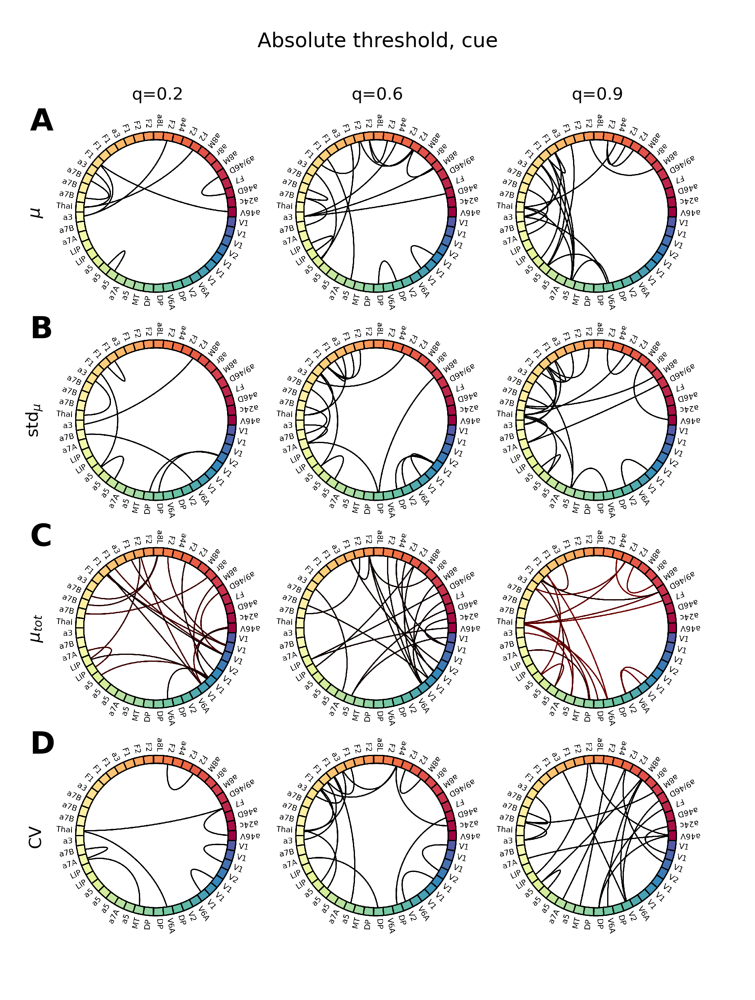

In [392]:
plot_conn_stage(1, False,20)

#### Cue surrogate

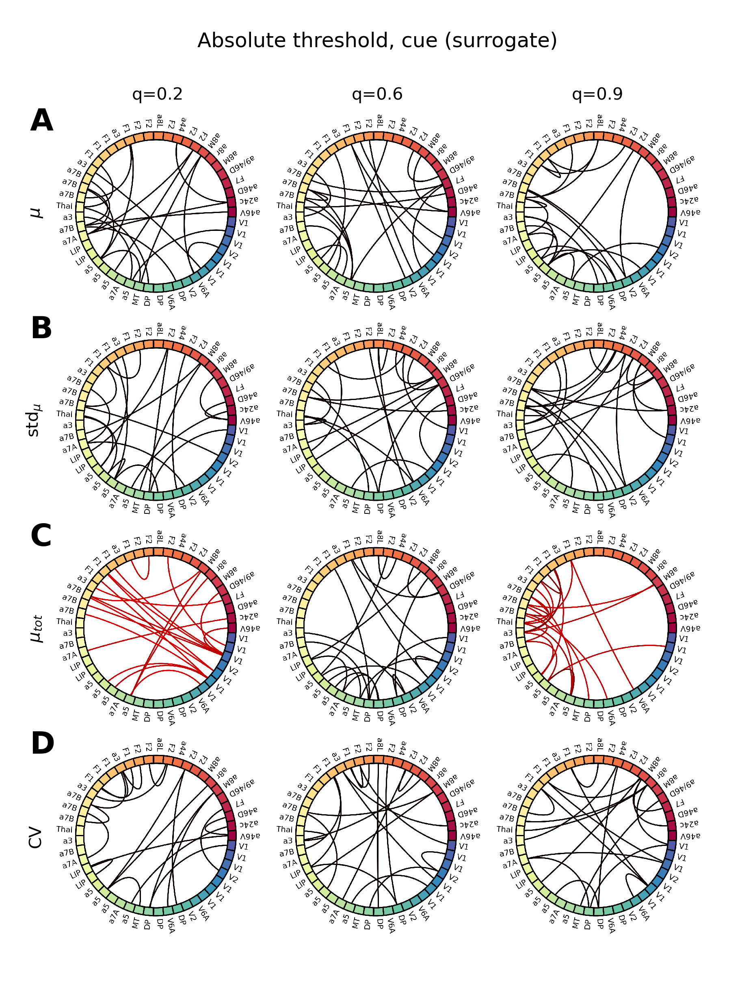

In [393]:
plot_conn_stage(1, True,20)

#### Delay original

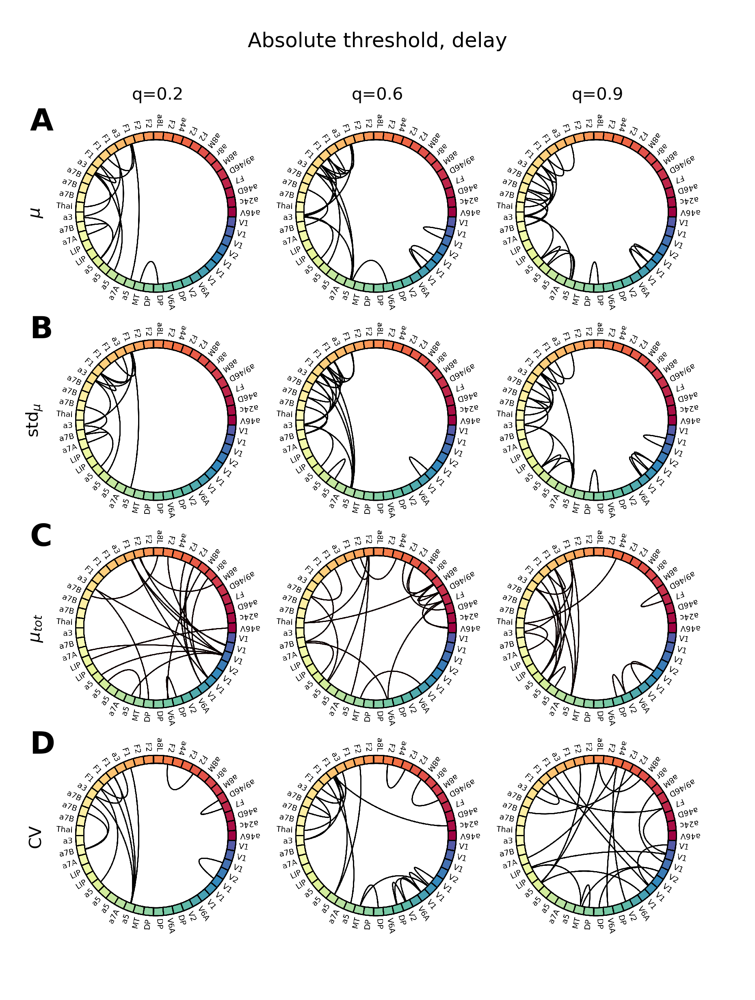

In [388]:
plot_conn_stage(2, False,20)

#### Delay surrogate

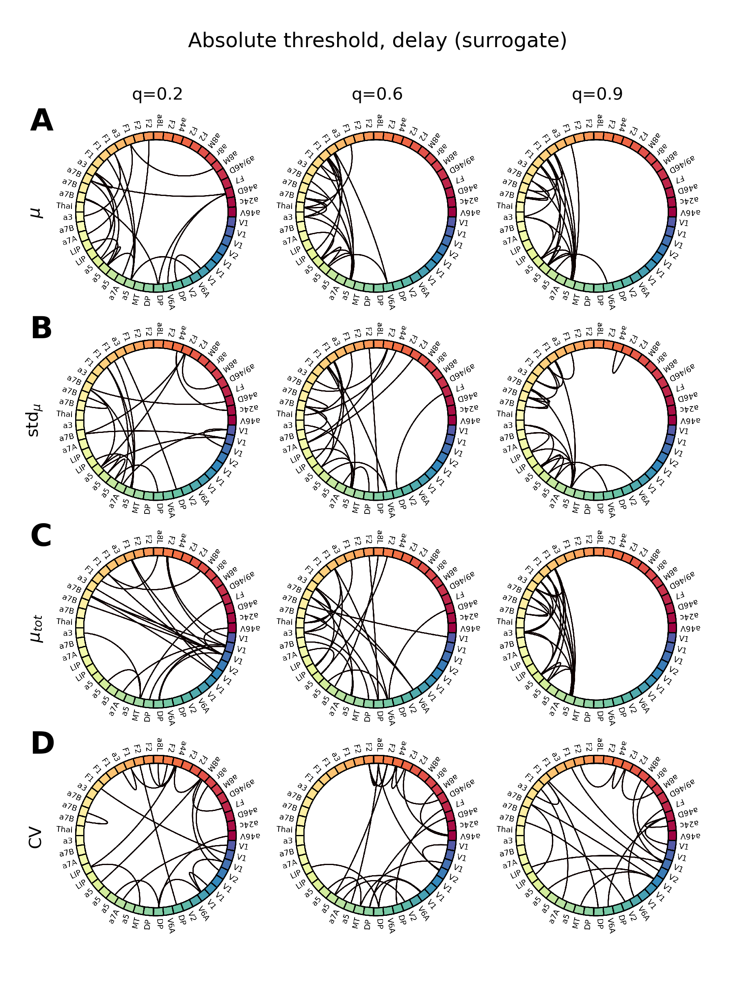

In [394]:
plot_conn_stage(2, True,20)

#### Match original

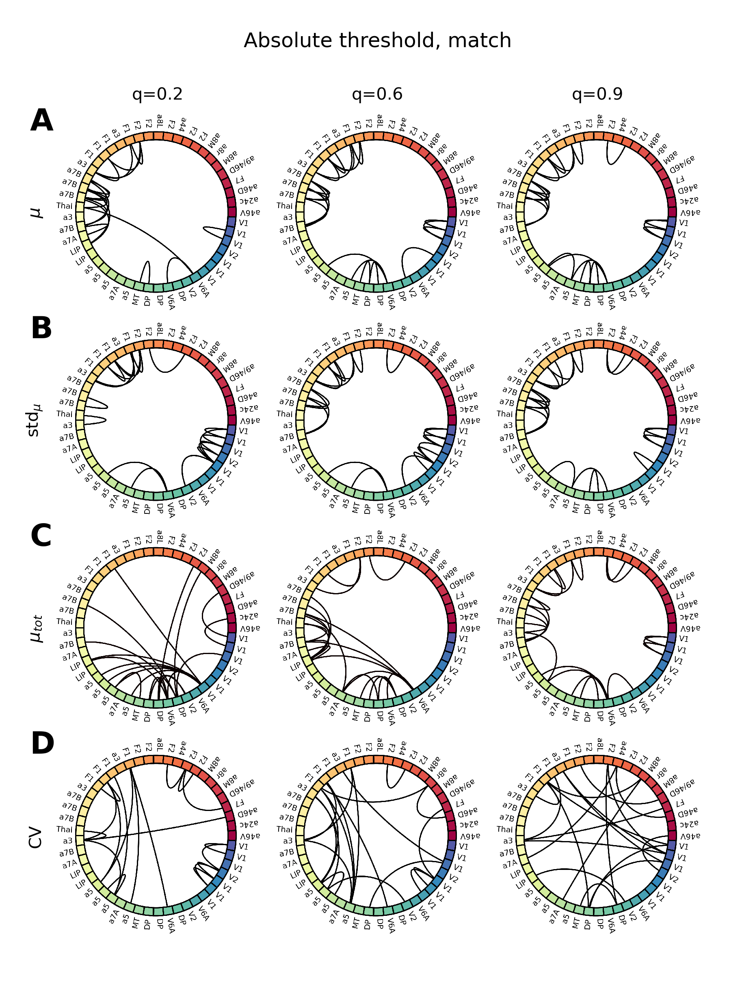

In [389]:
plot_conn_stage(3, False,20)

#### Match surrogate

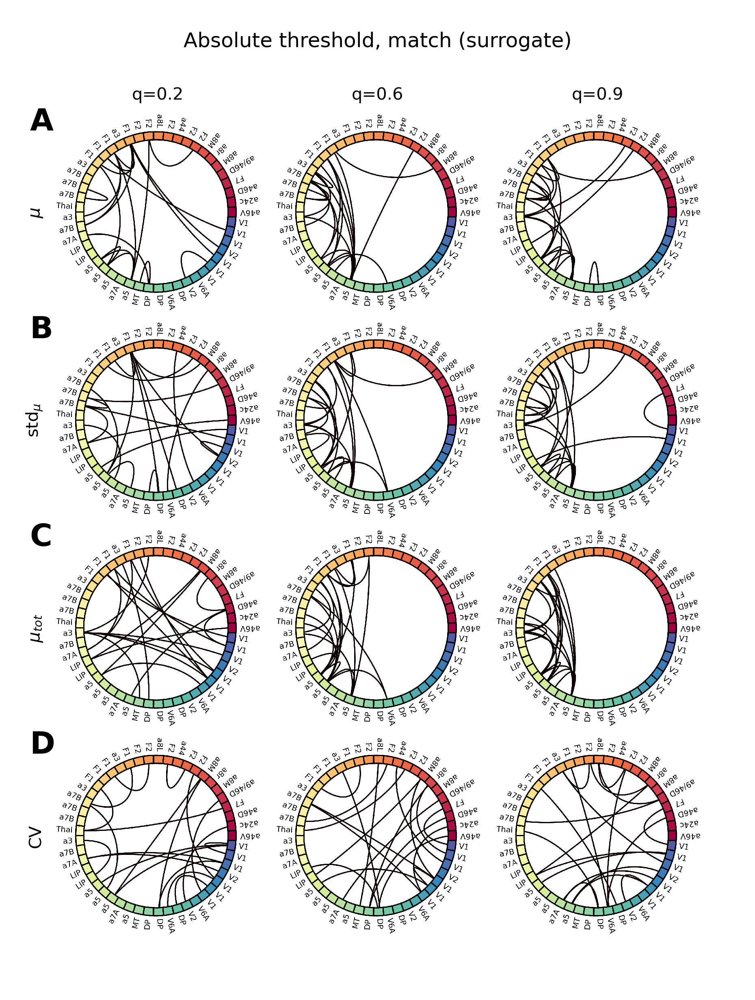

In [395]:
plot_conn_stage(3,True,20)